In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import joblib

### Handling Missing Values

In [47]:
train = pd.read_csv('GUIDE_Train.csv',nrows=500000)
train.head(2)

,Id,OrgId,IncidentId,AlertId,Timestamp,DetectorId,AlertTitle,Category,MitreTechniques,IncidentGrade,...,ResourceType,Roles,OSFamily,OSVersion,AntispamDirection,SuspicionLevel,LastVerdict,CountryCode,State,City
0,180388628218,0,612,123247,2024-06-04T06:05:15.000Z,7,6,InitialAccess,NaN,TruePositive,...,NaN,NaN,5,66,NaN,NaN,NaN,31,6,3
1,455266534868,88,326,210035,2024-06-14T03:01:25.000Z,58,43,Exfiltration,NaN,FalsePositive,...,NaN,NaN,5,66,NaN,NaN,NaN,242,1445,10630


In [48]:
test = pd.read_csv('GUIDE_Test.csv',nrows=500000)
test.head(2)

,Id,OrgId,IncidentId,AlertId,Timestamp,DetectorId,AlertTitle,Category,MitreTechniques,IncidentGrade,...,Roles,OSFamily,OSVersion,AntispamDirection,SuspicionLevel,LastVerdict,CountryCode,State,City,Usage
0,1245540519230,657,11767,87199,2024-06-04T22:56:27.000Z,524,563,LateralMovement,T1021;T1047;T1105;T1569.002,BenignPositive,...,NaN,5,66,NaN,Suspicious,Suspicious,242,1445,10630,Private
1,1400159342154,3,91158,632273,2024-06-03T12:58:26.000Z,2,2,CommandAndControl,NaN,BenignPositive,...,NaN,0,0,NaN,Suspicious,Suspicious,242,1445,10630,Public


In [ ]:
train.info()

In [ ]:
test.info()

In [ ]:
train.isnull().sum()

In [ ]:
test.isnull().sum()

In [53]:
columns_to_drop = [
    'Id', 'OrgId', 'IncidentId', 'AlertId', 'DetectorId', 'DeviceId', 'Sha256', 
    'NetworkMessageId', 'AccountSid', 'AccountObjectId', 
    'ApplicationId', 'OAuthApplicationId', 'ResourceIdName', 'IpAddress', 'Url', 
    'AccountName', 'DeviceName', 'RegistryKey', 'RegistryValueName', 
    'RegistryValueData', 'FileName', 'FolderPath', 'ApplicationName', 
    'ActionGrouped', 'ActionGranular', 'ResourceType'
]
train = train.drop(columns=columns_to_drop)
test = test.drop(columns= columns_to_drop)

In [54]:
train_num_cols = train.select_dtypes(include=np.number).columns
train_cat_cols = train.select_dtypes(exclude=np.number).columns

test_num_cols = test.select_dtypes(include=np.number).columns
test_cat_cols = test.select_dtypes(exclude=np.number).columns

In [55]:
train_num_cols, test_num_cols

(Index(['AlertTitle', 'AccountUpn', 'EmailClusterId', 'OSFamily', 'OSVersion',
        'CountryCode', 'State', 'City'],
       dtype='object'),
 Index(['AlertTitle', 'AccountUpn', 'EmailClusterId', 'OSFamily', 'OSVersion',
        'CountryCode', 'State', 'City'],
       dtype='object'))

In [56]:
train_cat_cols , test_cat_cols

(Index(['Timestamp', 'Category', 'MitreTechniques', 'IncidentGrade',
        'EntityType', 'EvidenceRole', 'ThreatFamily', 'Roles',
        'AntispamDirection', 'SuspicionLevel', 'LastVerdict'],
       dtype='object'),
 Index(['Timestamp', 'Category', 'MitreTechniques', 'IncidentGrade',
        'EntityType', 'EvidenceRole', 'ThreatFamily', 'Roles',
        'AntispamDirection', 'SuspicionLevel', 'LastVerdict', 'Usage'],
       dtype='object'))

In [57]:
for col in train_num_cols:
    if train[col].isnull().sum() > 0:
        print(col, train[col].isnull().sum())

EmailClusterId 494834


In [58]:
for col in test_num_cols:
    if test[col].isnull().sum() > 0:
        print(col, test[col].isnull().sum())

EmailClusterId 494927


In [59]:
len(train['EmailClusterId']), len(test['EmailClusterId'])

(500000, 500000)

In [60]:
print("EmailClusterId Missing in train : ",round((len(train[train['EmailClusterId'].isna() == True]) / len(train['EmailClusterId']) * 100),2),'%')

print("EmailClusterId Missing in test : ",round((len(test[test['EmailClusterId'].isna() == True]) / len(test['EmailClusterId']) * 100),2), '%')

EmailClusterId Missing in train :  98.97 %
EmailClusterId Missing in test :  98.99 %


The EmailClusterId column more than 98% of null values, hence dropping the column

In [61]:
train.drop(columns=['EmailClusterId'],inplace=True)
train_num_cols = train_num_cols.drop('EmailClusterId')

test.drop(columns=['EmailClusterId'],inplace=True)
test_num_cols = test_num_cols.drop('EmailClusterId')

In [62]:
print("Train Data: ")
for col in train_num_cols:
    print(col, train[col].isnull().sum())
print("\n")
print("Test Data:")
for col in test_num_cols:
    print(col, test[col].isnull().sum())

Train Data: 
AlertTitle 0
AccountUpn 0
OSFamily 0
OSVersion 0
CountryCode 0
State 0
City 0


Test Data:
AlertTitle 0
AccountUpn 0
OSFamily 0
OSVersion 0
CountryCode 0
State 0
City 0


In [63]:
# Percentage of null values in each column
print("Train Categorical Features ->")
for col in train_cat_cols:
    if train[col].isnull().sum() > 0:
        print(col,'=', round((train[col].isnull().sum() / len(train[col]) * 100),2),'%')
print("\n")
print("Test Categorical Features ->")
for col in test_cat_cols:
    if test[col].isnull().sum() > 0:
        print(col,'=', round((test[col].isnull().sum() / len(test[col]) * 100),2),'%')

Train Categorical Features ->
MitreTechniques = 57.47 %
IncidentGrade = 0.53 %
ThreatFamily = 99.22 %
Roles = 97.73 %
AntispamDirection = 98.17 %
SuspicionLevel = 84.84 %
LastVerdict = 76.58 %


Test Categorical Features ->
MitreTechniques = 55.58 %
ThreatFamily = 99.24 %
Roles = 97.36 %
AntispamDirection = 98.14 %
SuspicionLevel = 84.34 %
LastVerdict = 76.06 %


In [64]:
# Imputing mode for the missing values

for col in train_cat_cols.drop('IncidentGrade'):
    if train[col].isnull().sum() > 0:
        train[col] = train[col].fillna(train[col].mode()[0])
print("Imputed Train data")

for col in test_cat_cols:
    if test[col].isnull().sum() > 0:
        test[col] = test[col].fillna(test[col].mode()[0])
print("Imputed Test data")

Imputed Train data
Imputed Test data


In [65]:
def process_timestamp_column(df):

    df['Timestamp'] = pd.to_datetime(df['Timestamp'])

    df['Year'] = df['Timestamp'].dt.year
    df['Month'] = df['Timestamp'].dt.month
    df['Day'] = df['Timestamp'].dt.day
    df['Hour'] = df['Timestamp'].dt.hour
    df['Minute'] = df['Timestamp'].dt.minute
    df['Second'] = df['Timestamp'].dt.second
    df['DayOfWeek'] = df['Timestamp'].dt.dayofweek
    df['IsWeekend'] = (df['DayOfWeek'] >= 5).astype(int)

    # Drop the original timestamp column
    df.drop(columns=['Timestamp'], inplace=True)
    
    return df

train = process_timestamp_column(train)
test = process_timestamp_column(test)

In [66]:
train['MitreTechniques'].head(2), test['MitreTechniques'].head(2)

(0    T1078;T1078.004
 1    T1078;T1078.004
 Name: MitreTechniques, dtype: object,
 0    T1021;T1047;T1105;T1569.002
 1                T1078;T1078.004
 Name: MitreTechniques, dtype: object)

In [67]:
# Split techniques into lists
train['MitreTechniques_List'] = train['MitreTechniques'].str.split(';')
test['MitreTechniques_List'] = test['MitreTechniques'].str.split(';')

In [68]:
train = train.drop(columns=['MitreTechniques'],axis=1)
test = test.drop(columns=['MitreTechniques'],axis=1)

In [69]:
train_num_cols = train.select_dtypes(include=np.number).columns
train_cat_cols = train.select_dtypes(exclude=np.number).columns

test_num_cols = test.select_dtypes(include=np.number).columns
test_cat_cols = test.select_dtypes(exclude=np.number).columns

In [70]:
train['IncidentGrade'].value_counts()

IncidentGrade
BenignPositive    215445
TruePositive      174991
FalsePositive     106908
Name: count, dtype: int64

In [71]:
train_cat_cols

Index(['Category', 'IncidentGrade', 'EntityType', 'EvidenceRole',
       'ThreatFamily', 'Roles', 'AntispamDirection', 'SuspicionLevel',
       'LastVerdict', 'MitreTechniques_List'],
      dtype='object')

In [72]:
top_10_cats = train['Category'].value_counts().nlargest(10).index
train['Category'] = train['Category'].apply( lambda x: x if x in top_10_cats else 'Others')

top_5_entity = train['EntityType'].value_counts().nlargest(5).index
train['EntityType'] = train['EntityType'].apply( lambda x: x if x in top_5_entity else 'Others')

top_5_threatfamily = train['ThreatFamily'].value_counts().nlargest(5).index
train['ThreatFamily'] = train['ThreatFamily'].apply( lambda x: x if x in top_5_threatfamily else 'Others')

top_5_mitre_techs = train['MitreTechniques_List'].value_counts().head(5).index
top_5_mitre_techs = [tuple(item) for item in top_5_mitre_techs]
train['MitreTechniques_List'] = train['MitreTechniques_List'].apply(lambda x: tuple(x) if tuple(x) in top_5_mitre_techs else 'Others')

top_3_antispam_dir = train['AntispamDirection'].value_counts().nlargest(2).index
train['AntispamDirection'] = train['AntispamDirection'].apply( lambda x: x if x in top_3_antispam_dir else 'Others')

top_2_lastverdict = train['LastVerdict'].value_counts().nlargest(2).index
train['LastVerdict'] = train['LastVerdict'].apply( lambda x: x if x in top_2_lastverdict else 'Others')

top_5_roles = train['Roles'].value_counts().nlargest(5).index
train['Roles'] = train['Roles'].apply( lambda x: x if x in top_5_roles else 'Others')

In [73]:
train['Roles'].value_counts()

Roles
Contextual     495442
Destination      1771
Suspicious       1513
Attacker          660
Source            395
Others            219
Name: count, dtype: int64

In [74]:
train['SuspicionLevel'].value_counts()

SuspicionLevel
Suspicious      499926
Incriminated        74
Name: count, dtype: int64

In [75]:
train['AntispamDirection'].value_counts()

AntispamDirection
Inbound     499224
Intraorg       733
Others          43
Name: count, dtype: int64

In [76]:
train['LastVerdict'].value_counts()

LastVerdict
Suspicious    456609
Malicious      22559
Others         20832
Name: count, dtype: int64

In [77]:
test['Usage'].value_counts()

Usage
Public     351548
Private    148452
Name: count, dtype: int64

In [78]:
test_cat_cols

Index(['Category', 'IncidentGrade', 'EntityType', 'EvidenceRole',
       'ThreatFamily', 'Roles', 'AntispamDirection', 'SuspicionLevel',
       'LastVerdict', 'Usage', 'MitreTechniques_List'],
      dtype='object')

In [79]:
top_10_cats = test['Category'].value_counts().nlargest(10).index
test['Category'] = test['Category'].apply( lambda x: x if x in top_10_cats else 'Others')

top_5_entity = test['EntityType'].value_counts().nlargest(5).index
test['EntityType'] = test['EntityType'].apply( lambda x: x if x in top_5_entity else 'Others')

top_5_threatfamily = test['ThreatFamily'].value_counts().nlargest(5).index
test['ThreatFamily'] = test['ThreatFamily'].apply( lambda x: x if x in top_5_threatfamily else 'Others')

top_5_mitre_techs = test['MitreTechniques_List'].value_counts().head(5).index
top_5_mitre_techs = [tuple(item) for item in top_5_mitre_techs]
test['MitreTechniques_List'] = test['MitreTechniques_List'].apply(lambda x: tuple(x) if tuple(x) in top_5_mitre_techs else 'Others')

top_3_antispam_dir = test['AntispamDirection'].value_counts().nlargest(3).index
test['AntispamDirection'] = test['AntispamDirection'].apply( lambda x: x if x in top_3_antispam_dir else 'Others')

top_2_lastverdict = test['LastVerdict'].value_counts().nlargest(2).index
test['LastVerdict'] = test['LastVerdict'].apply( lambda x: x if x in top_2_lastverdict else 'Others')

test_5_roles = test['Roles'].value_counts().nlargest(5).index
test['Roles'] = test['Roles'].apply( lambda x: x if x in test_5_roles else 'Others')

In [80]:
test['AntispamDirection'].value_counts()

AntispamDirection
Inbound     499180
Intraorg       781
Outbound        39
Name: count, dtype: int64

In [81]:
test['SuspicionLevel'].value_counts()

SuspicionLevel
Suspicious      499957
Incriminated        43
Name: count, dtype: int64

In [82]:
test['LastVerdict'].value_counts()

LastVerdict
Suspicious    456684
Malicious      22530
Others         20786
Name: count, dtype: int64

### EDA

In [136]:
train.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
AlertTitle,500000.0,NaN,NaN,NaN,2948.050928,11452.270459,0.0,2.0,11.0,181.0,113167.0
Category,500000,11,InitialAccess,225467,NaN,NaN,NaN,NaN,NaN,NaN,NaN
IncidentGrade,497344,3,BenignPositive,215445,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EntityType,500000,6,Others,149878,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EvidenceRole,500000,2,Related,273389,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AccountUpn,500000.0,NaN,NaN,NaN,463902.406496,290462.872003,0.0,91527.75,673934.0,673934.0,673934.0
ThreatFamily,500000,6,Phish,496270,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Roles,500000,9,Contextual,495442,NaN,NaN,NaN,NaN,NaN,NaN,NaN
OSFamily,500000.0,NaN,NaN,NaN,4.900448,0.696938,0.0,5.0,5.0,5.0,5.0
OSVersion,500000.0,NaN,NaN,NaN,64.680582,9.229781,0.0,66.0,66.0,66.0,66.0


In [137]:
test.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
AlertTitle,500000.0,NaN,NaN,NaN,2523.998052,10442.246212,0.0,2.0,9.0,115.0,113132.0
Category,500000,11,InitialAccess,235616,NaN,NaN,NaN,NaN,NaN,NaN,NaN
IncidentGrade,500000,3,BenignPositive,211593,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EntityType,500000,6,Others,151763,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EvidenceRole,500000,2,Related,276406,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AccountUpn,500000.0,NaN,NaN,NaN,471068.071056,288261.592723,0.0,102578.25,673934.0,673934.0,673934.0
ThreatFamily,500000,6,CustomEnterpriseBlockOnly,496467,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Roles,500000,8,Contextual,494016,NaN,NaN,NaN,NaN,NaN,NaN,NaN
OSFamily,500000.0,NaN,NaN,NaN,4.899272,0.701058,0.0,5.0,5.0,5.0,5.0
OSVersion,500000.0,NaN,NaN,NaN,64.66555,9.280628,0.0,66.0,66.0,66.0,66.0


In [138]:
print(train.isnull().sum())
print(test.isnull().sum())

AlertTitle                 0
Category                   0
IncidentGrade           2656
EntityType                 0
EvidenceRole               0
AccountUpn                 0
ThreatFamily               0
Roles                      0
OSFamily                   0
OSVersion                  0
AntispamDirection          0
SuspicionLevel             0
LastVerdict                0
CountryCode                0
State                      0
City                       0
Year                       0
Month                      0
Day                        0
Hour                       0
Minute                     0
Second                     0
DayOfWeek                  0
IsWeekend                  0
MitreTechniques_List       0
dtype: int64
AlertTitle              0
Category                0
IncidentGrade           0
EntityType              0
EvidenceRole            0
AccountUpn              0
ThreatFamily            0
Roles                   0
OSFamily                0
OSVersion               0
An

In [139]:
for col in train.columns:
    print(f'{col}: {train[col].nunique()} unique values')


AlertTitle: 33042 unique values
Category: 11 unique values
IncidentGrade: 3 unique values
EntityType: 6 unique values
EvidenceRole: 2 unique values
AccountUpn: 102427 unique values
ThreatFamily: 6 unique values
Roles: 9 unique values
OSFamily: 4 unique values
OSVersion: 23 unique values
AntispamDirection: 3 unique values
SuspicionLevel: 2 unique values
LastVerdict: 3 unique values
CountryCode: 151 unique values
State: 638 unique values
City: 2138 unique values
Year: 2 unique values
Month: 7 unique values
Day: 31 unique values
Hour: 24 unique values
Minute: 60 unique values
Second: 60 unique values
DayOfWeek: 7 unique values
IsWeekend: 2 unique values
MitreTechniques_List: 6 unique values


In [140]:
for col in test.columns:
    print(f'{col}: {test[col].nunique()} unique values')

AlertTitle: 24407 unique values
Category: 11 unique values
IncidentGrade: 3 unique values
EntityType: 6 unique values
EvidenceRole: 2 unique values
AccountUpn: 92742 unique values
ThreatFamily: 6 unique values
Roles: 8 unique values
OSFamily: 5 unique values
OSVersion: 24 unique values
AntispamDirection: 3 unique values
SuspicionLevel: 2 unique values
LastVerdict: 3 unique values
CountryCode: 147 unique values
State: 648 unique values
City: 2152 unique values
Usage: 2 unique values
Year: 2 unique values
Month: 8 unique values
Day: 31 unique values
Hour: 24 unique values
Minute: 60 unique values
Second: 60 unique values
DayOfWeek: 7 unique values
IsWeekend: 2 unique values
MitreTechniques_List: 6 unique values


In [141]:
train['IncidentGrade'].value_counts()

IncidentGrade
BenignPositive    215445
TruePositive      174991
FalsePositive     106908
Name: count, dtype: int64

In [142]:
test['IncidentGrade'].value_counts()

IncidentGrade
BenignPositive    211593
TruePositive      180069
FalsePositive     108338
Name: count, dtype: int64

In [143]:
fig = px.histogram(train, x=train['IncidentGrade'])
fig.update_layout(title='IncidentGrade Distribution of Train Data')
fig.show()

In [144]:
fig = px.histogram(test, x=test['IncidentGrade'])
fig.update_layout(title='IncidentGrade Distribution of Test Data')
fig.show()

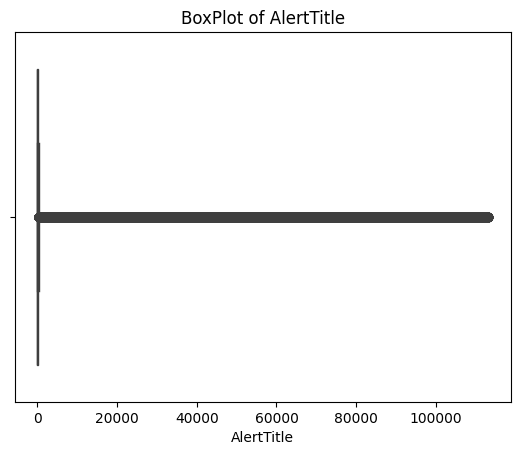

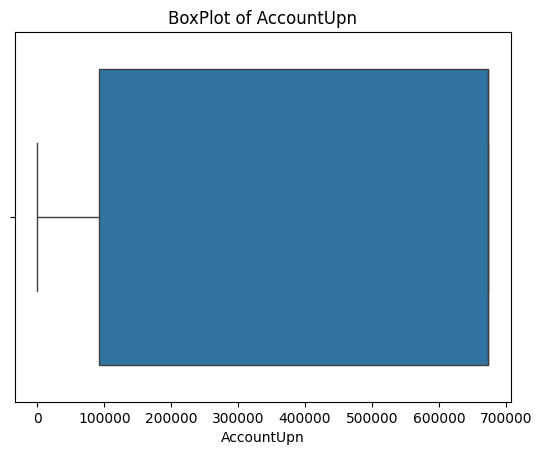

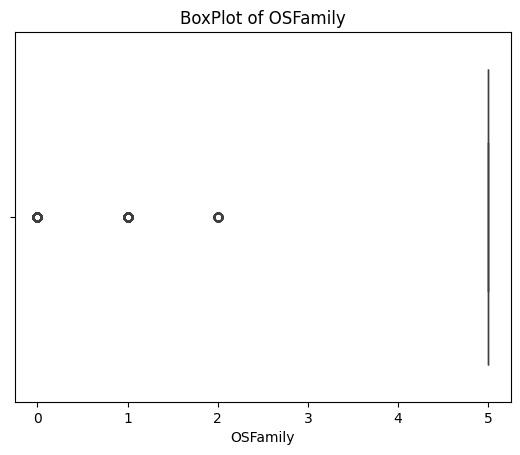

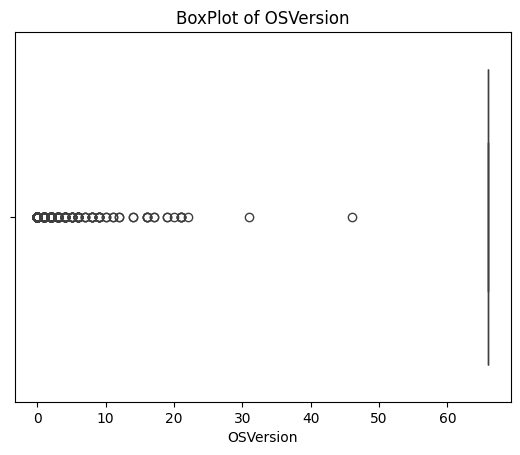

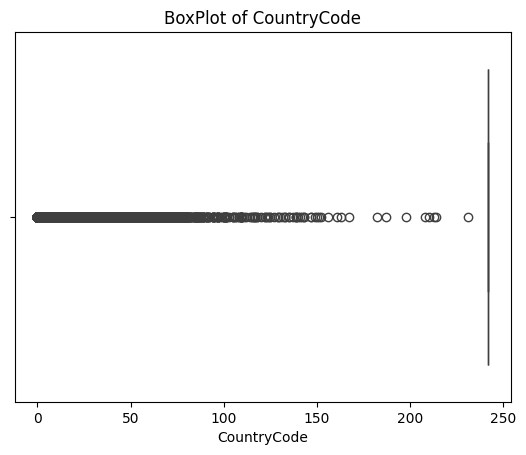

...

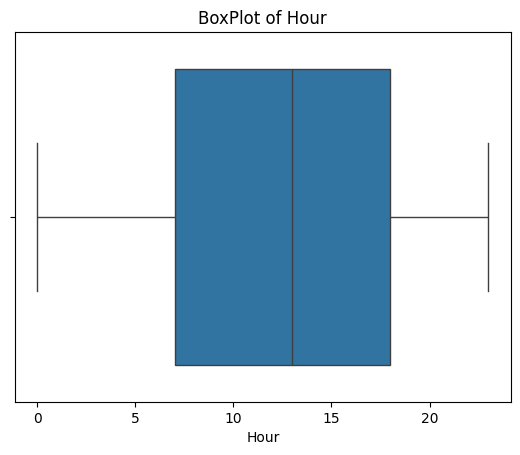

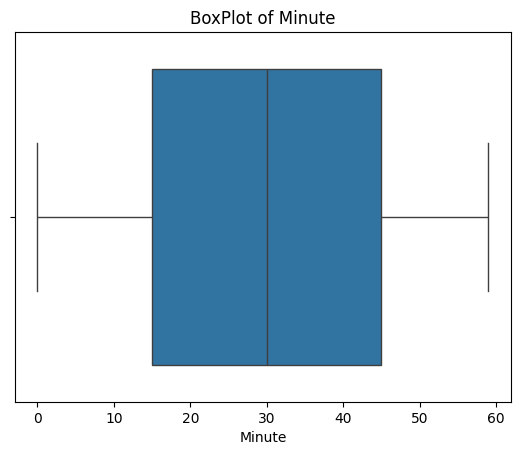

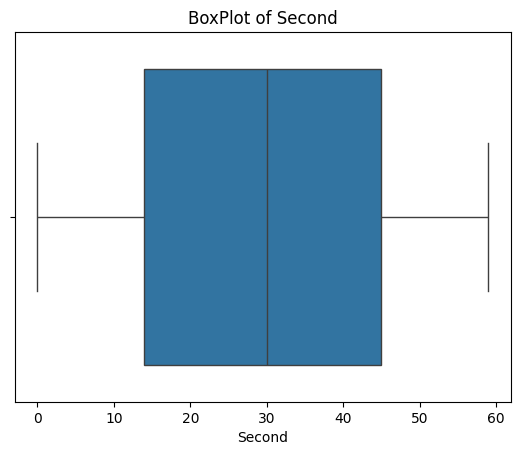

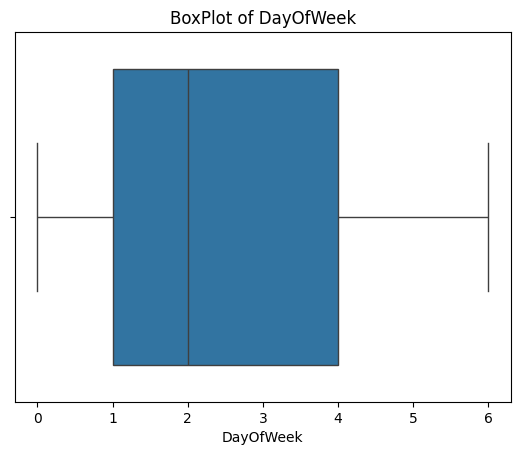

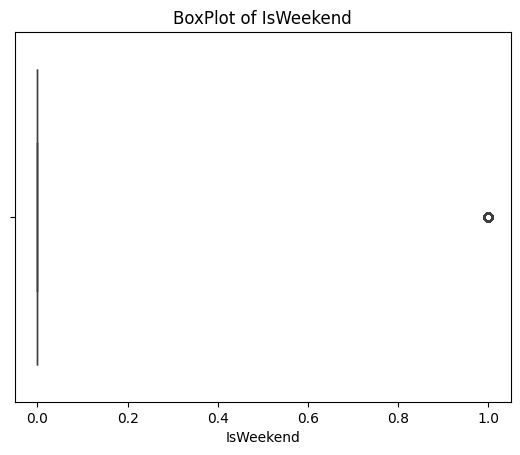

In [145]:
for col in train_num_cols:
    sns.boxplot(data=train,x=col)
    plt.title(f'BoxPlot of {col}')
    plt.show()

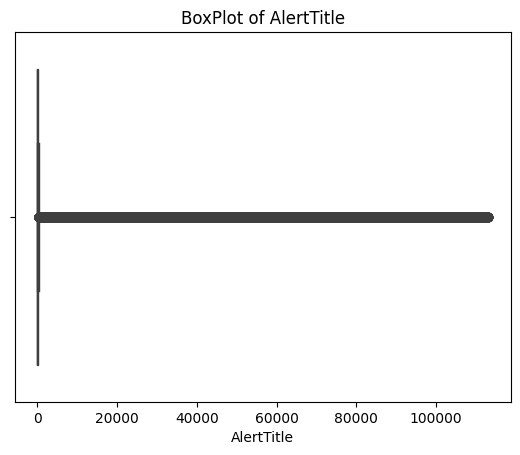

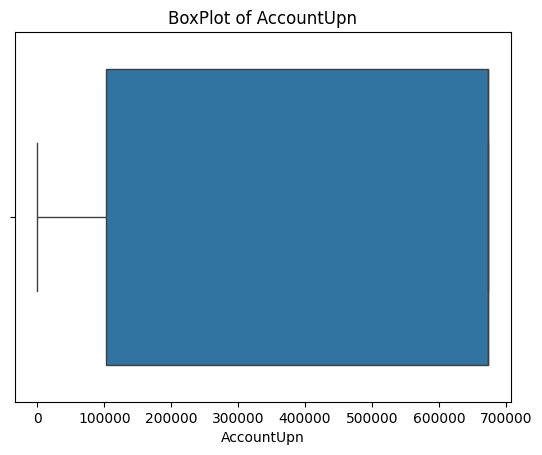

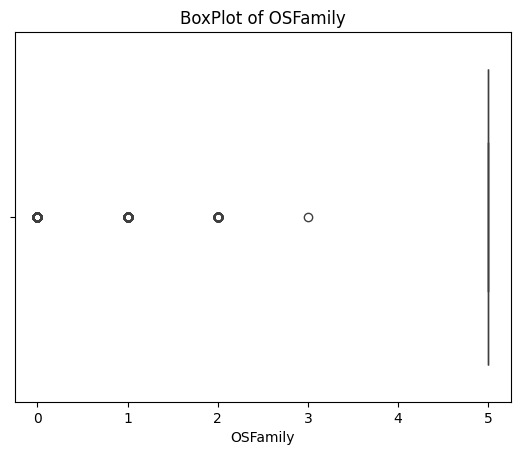

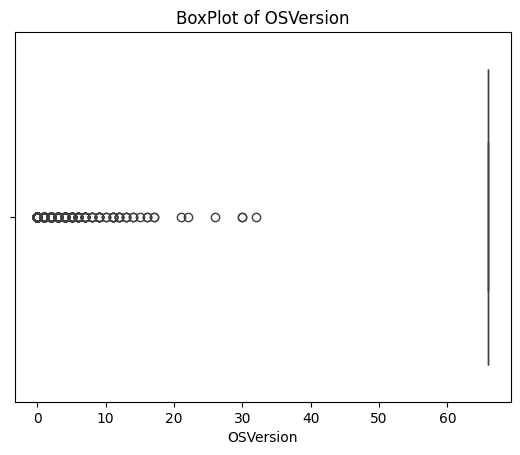

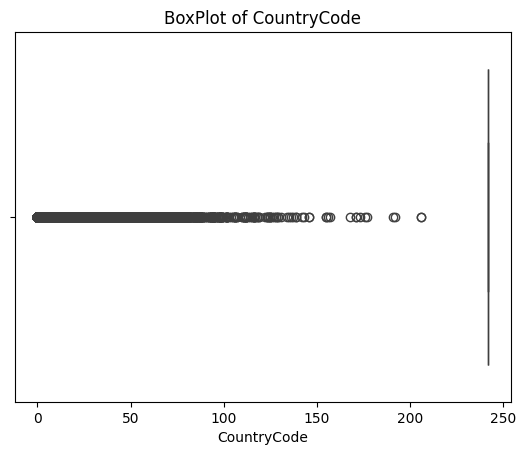

...

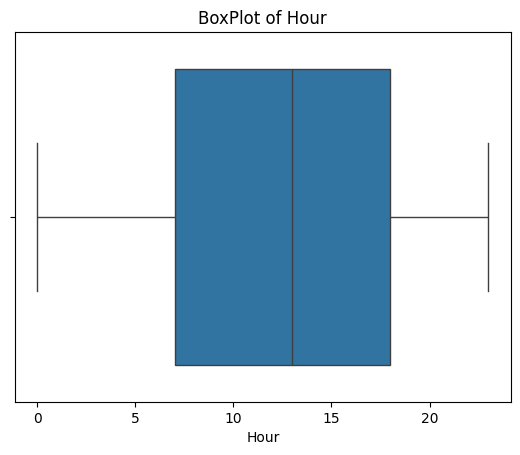

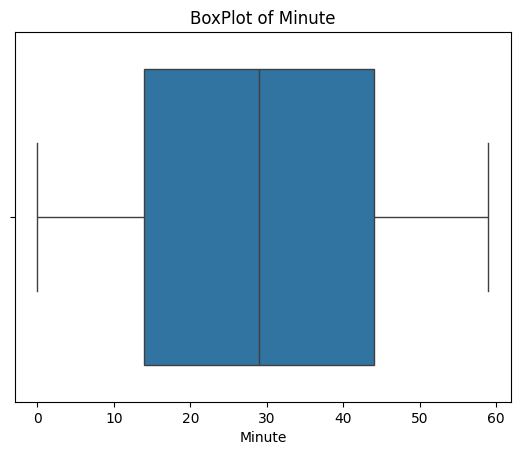

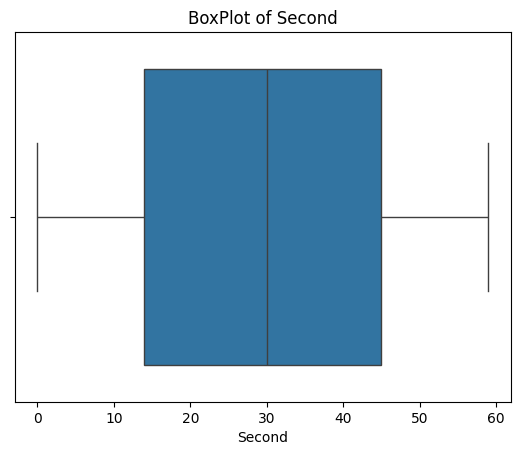

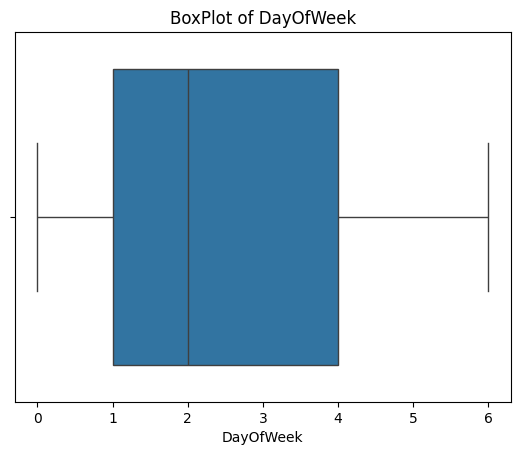

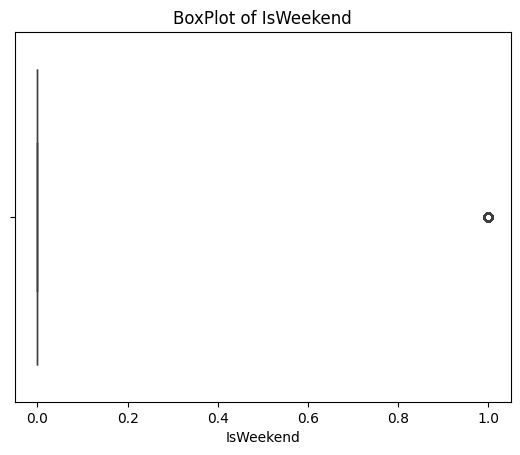

In [146]:
for col in test_num_cols:
    sns.boxplot(data=test,x=col)
    plt.title(f'BoxPlot of {col}')
    plt.show()

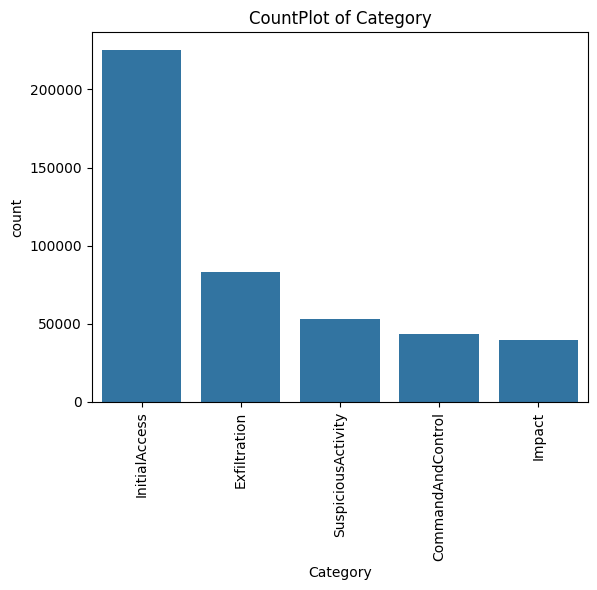

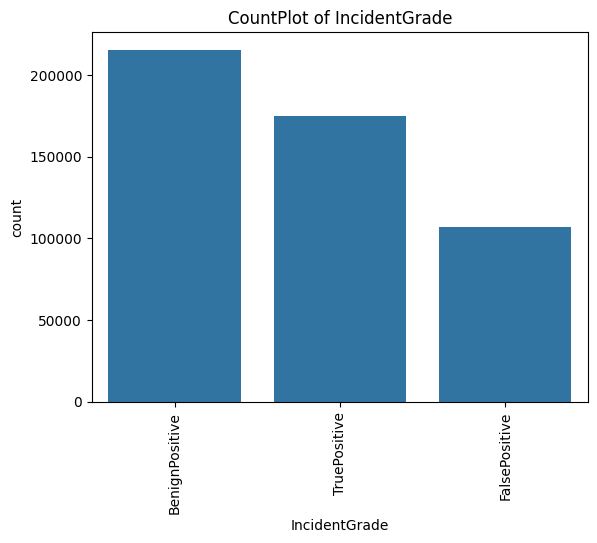

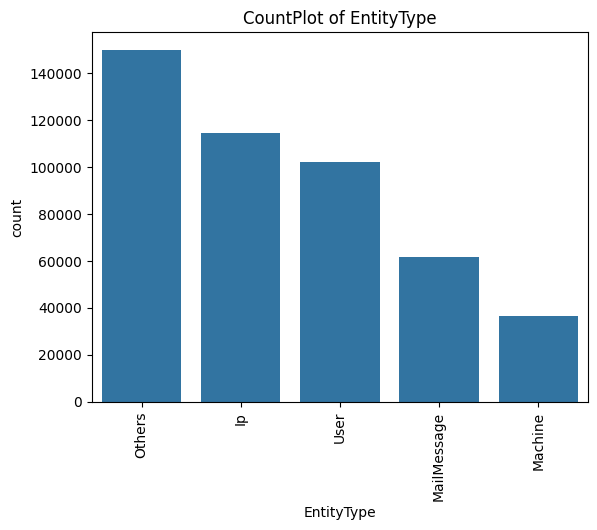

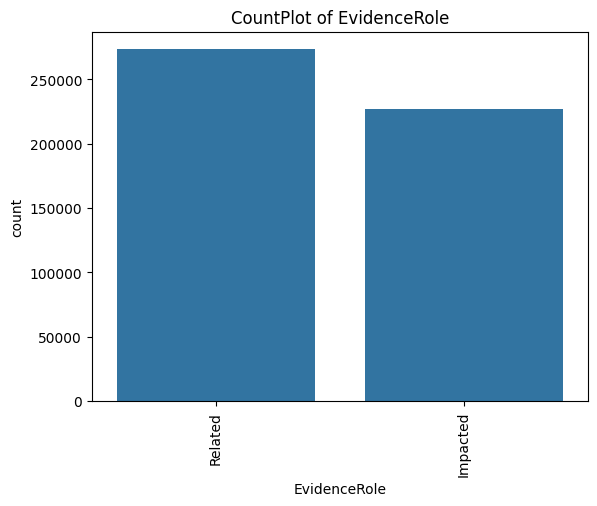

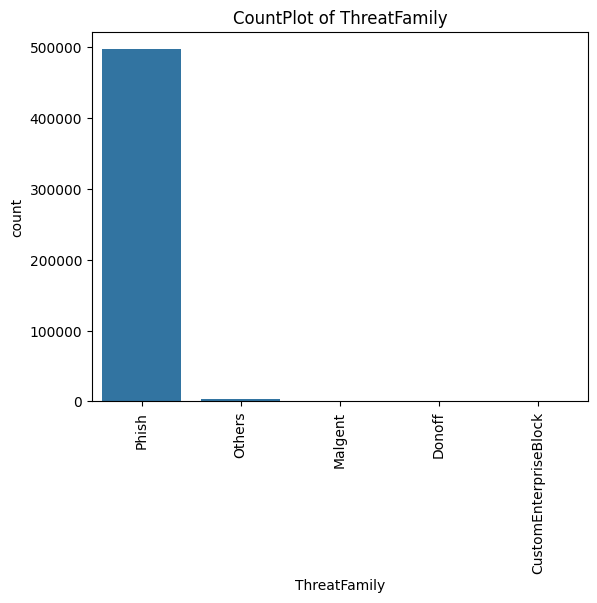

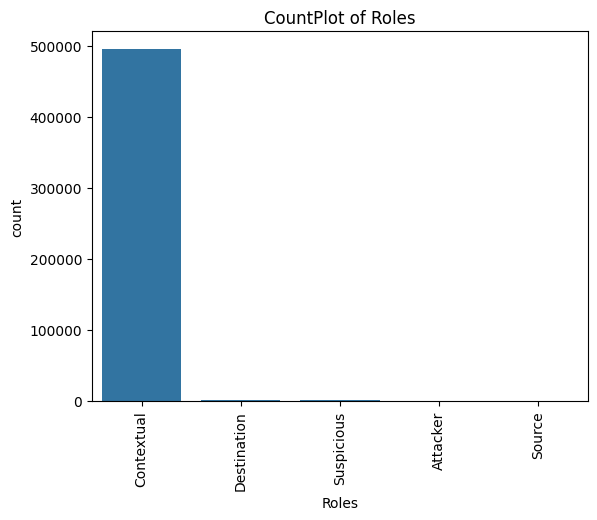

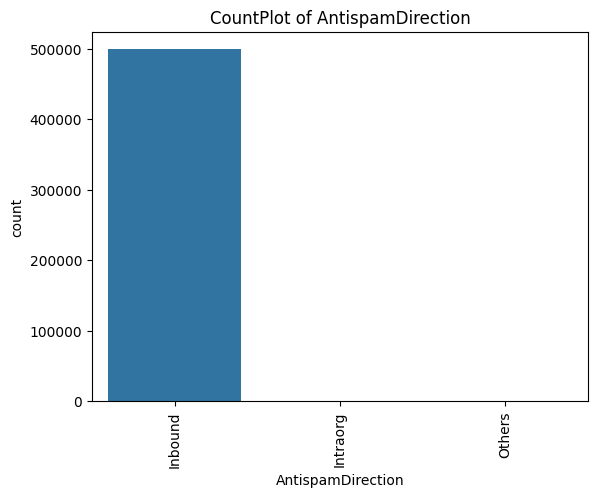

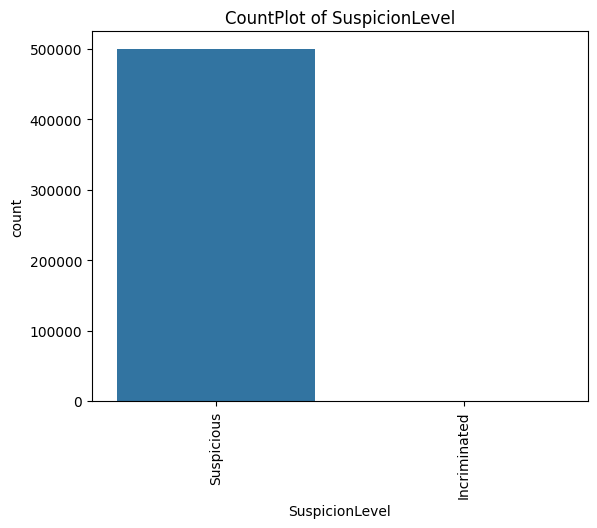

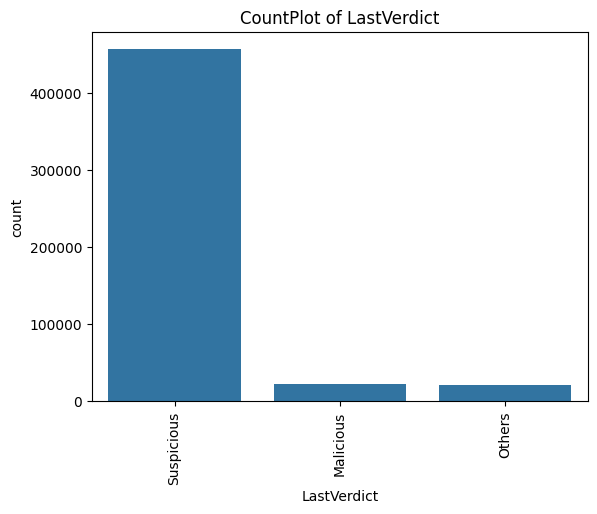

In [147]:
for col in train_cat_cols[:-1]:
    # top5 = train_sample[col].value_counts().head(5)
    sns.countplot(data=train, x=col, order=train[col].value_counts().index[:5])
    plt.title(f'CountPlot of {col}')
    plt.xlabel(col)
    plt.xticks(rotation=90)
    plt.show()

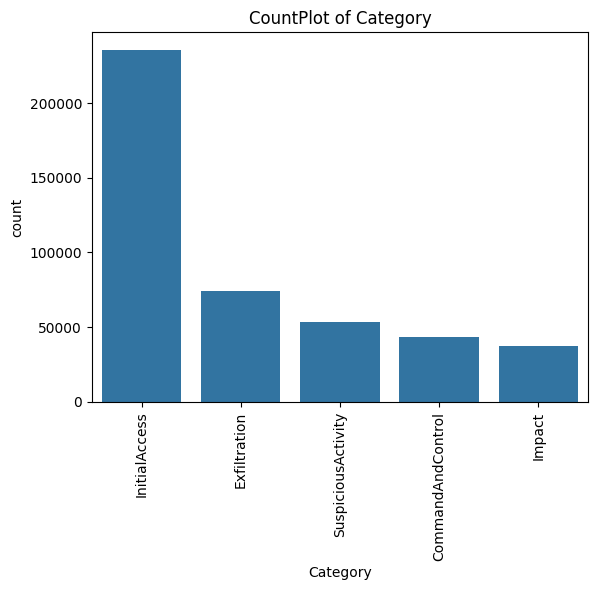

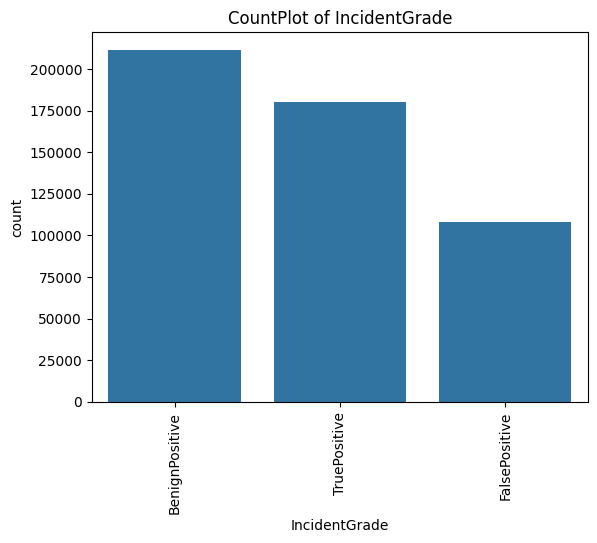

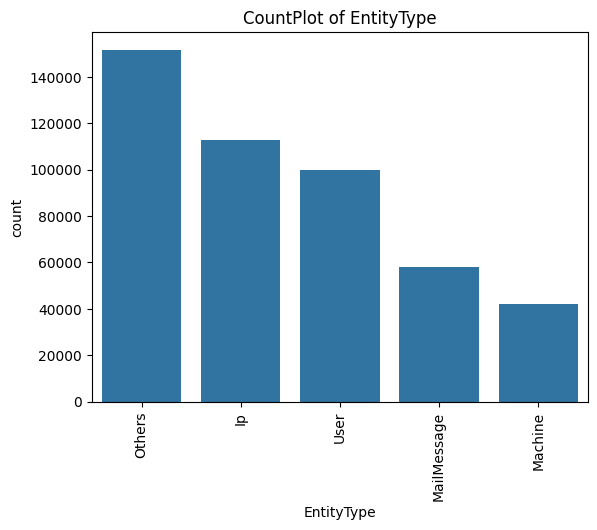

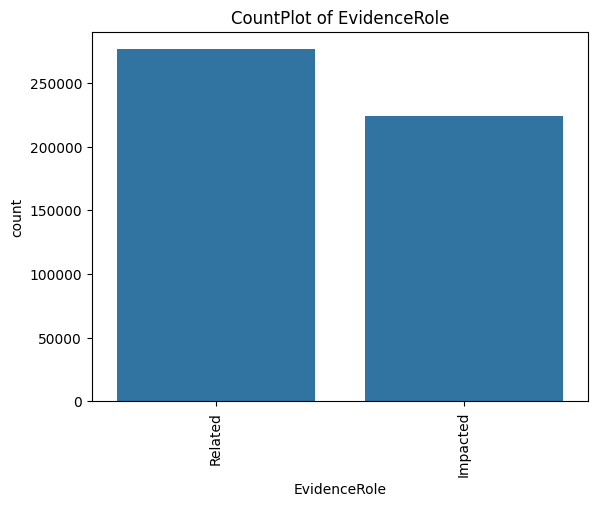

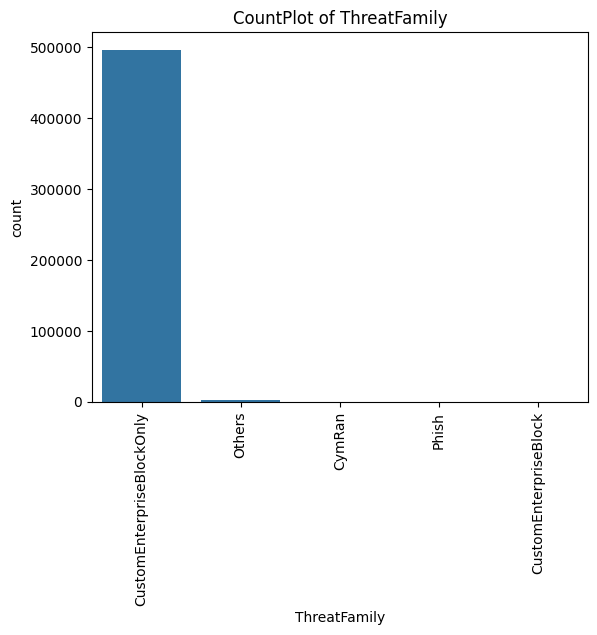

...

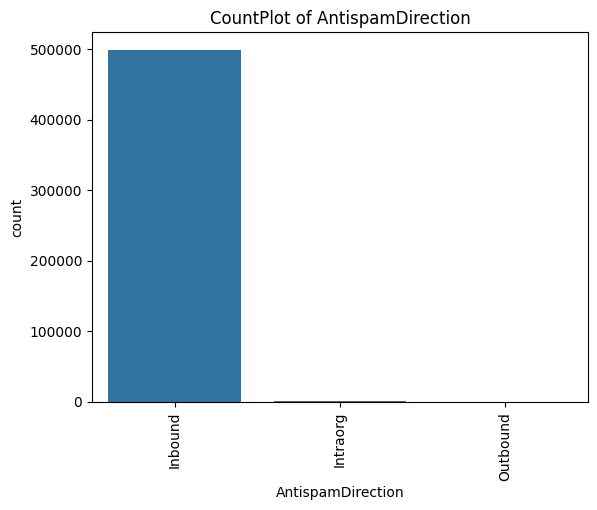

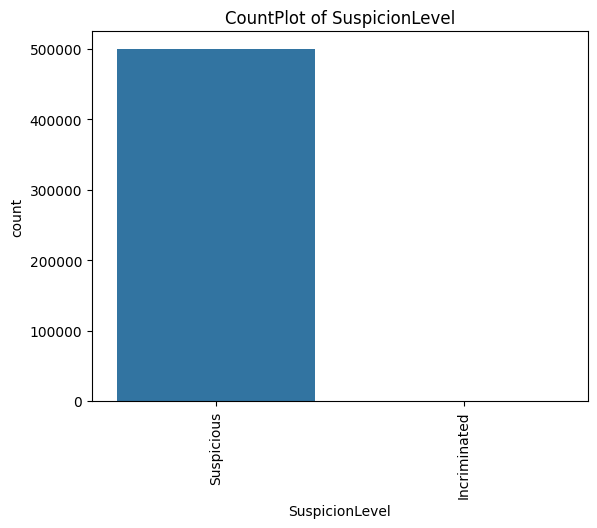

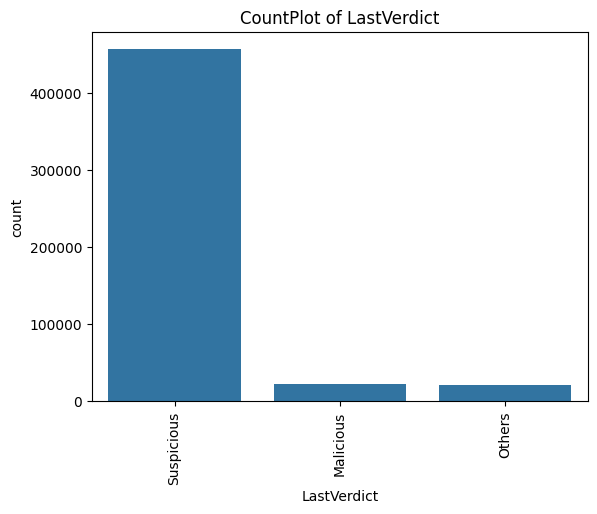

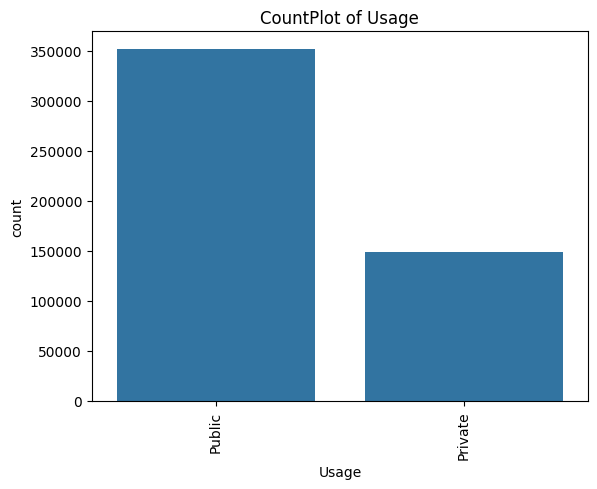

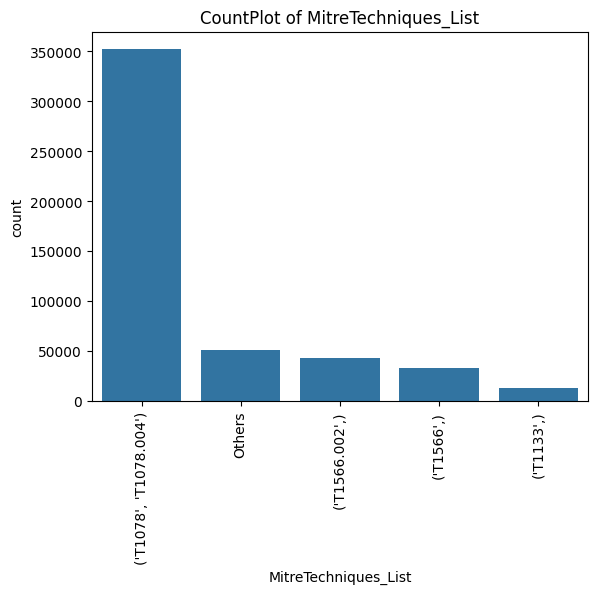

In [148]:
for col in test_cat_cols:
    # top5 = train_sample[col].value_counts().head(5)
    sns.countplot(data=test, x=col, order=test[col].value_counts().index[:5])
    plt.title(f'CountPlot of {col}')
    plt.xlabel(col)
    plt.xticks(rotation=90)
    plt.show()

Text(0.5, 1.0, 'Incidents by Month')

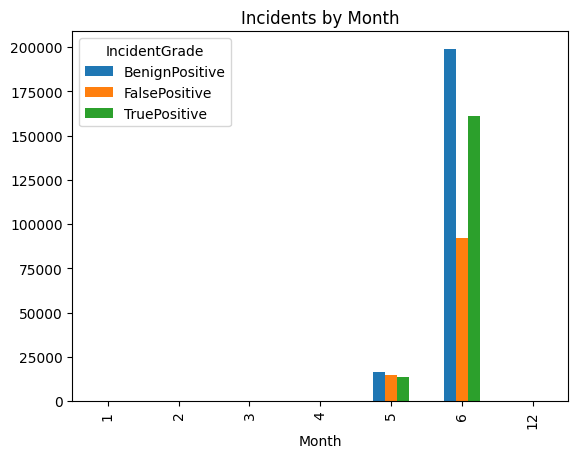

In [149]:
train.groupby('Month')['IncidentGrade'].value_counts().unstack().plot(kind='bar')
plt.title('Incidents by Month')

Text(0.5, 1.0, 'Incidents by Month')

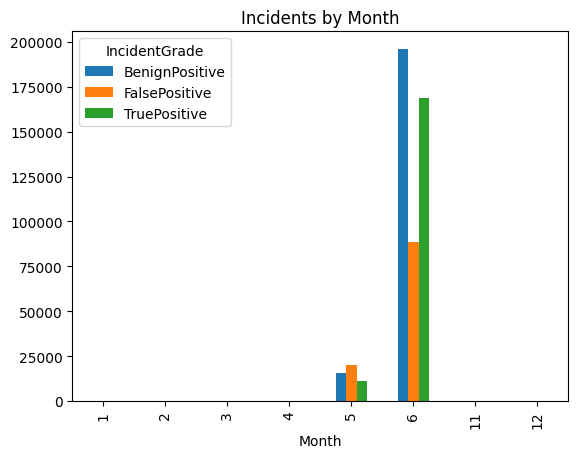

In [150]:
test.groupby('Month')['IncidentGrade'].value_counts().unstack().plot(kind='bar')
plt.title('Incidents by Month')

Text(0.5, 1.0, 'Incidents by DayOfWeek')

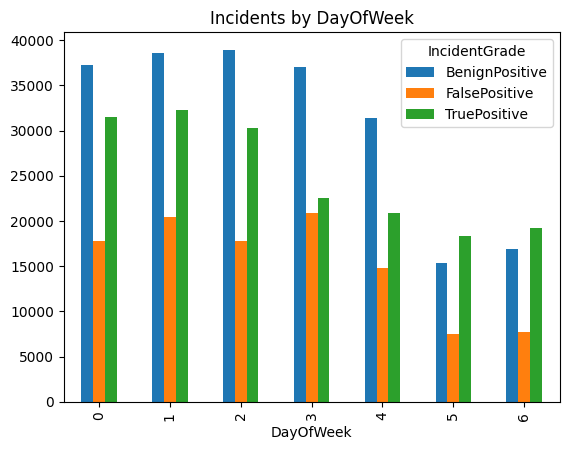

In [151]:
train.groupby('DayOfWeek')['IncidentGrade'].value_counts().unstack().plot(kind='bar')
plt.title('Incidents by DayOfWeek')

Text(0.5, 1.0, 'Incidents by DayOfWeek')

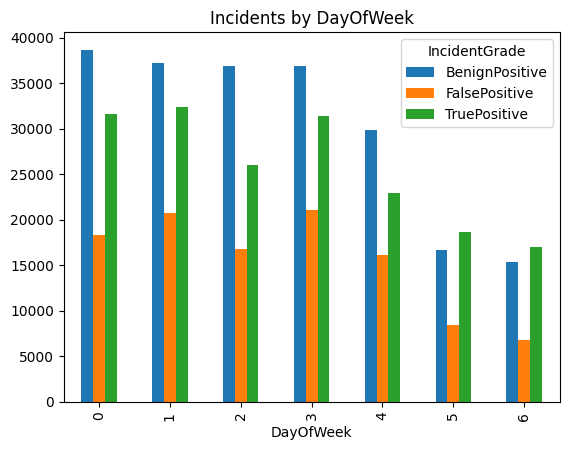

In [152]:
test.groupby('DayOfWeek')['IncidentGrade'].value_counts().unstack().plot(kind='bar')
plt.title('Incidents by DayOfWeek')

Text(0.5, 1.0, 'Incidents by Weekend')

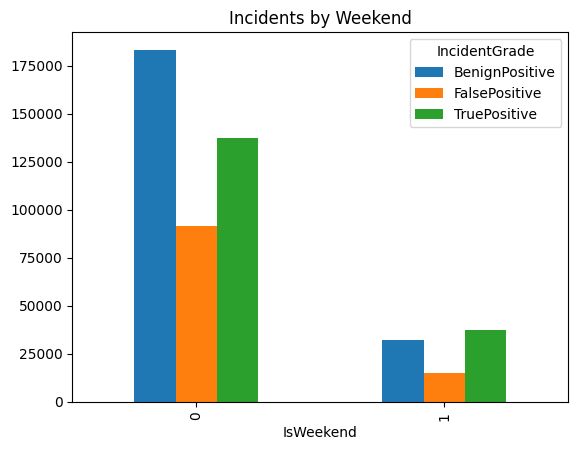

In [153]:
train.groupby('IsWeekend')['IncidentGrade'].value_counts().unstack().plot(kind='bar')
plt.title('Incidents by Weekend')

Text(0.5, 1.0, 'Incidents by Weekend')

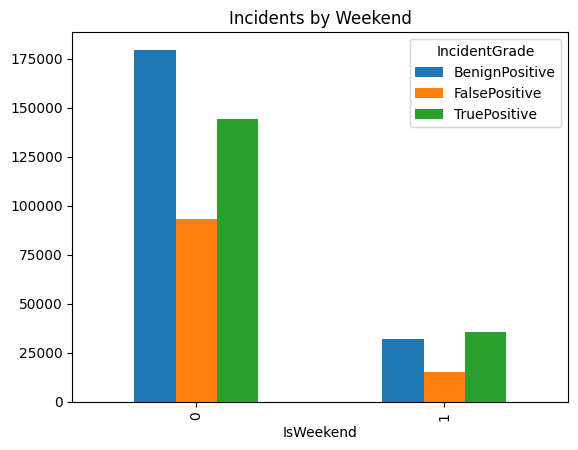

In [154]:
test.groupby('IsWeekend')['IncidentGrade'].value_counts().unstack().plot(kind='bar')
plt.title('Incidents by Weekend')

Text(0.5, 1.0, 'Incidents by Hour')

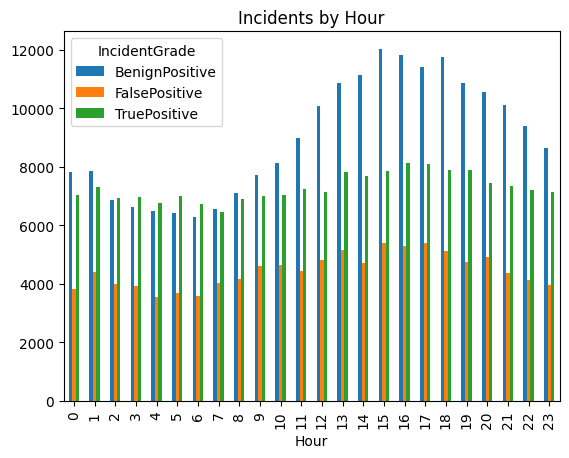

In [155]:
train.groupby('Hour')['IncidentGrade'].value_counts().unstack().plot(kind='bar')
plt.title('Incidents by Hour')

Text(0.5, 1.0, 'Incidents by Hour')

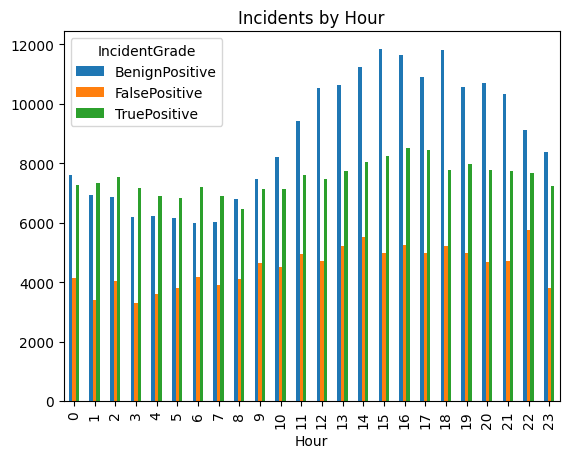

In [156]:
test.groupby('Hour')['IncidentGrade'].value_counts().unstack().plot(kind='bar')
plt.title('Incidents by Hour')

<Axes: >

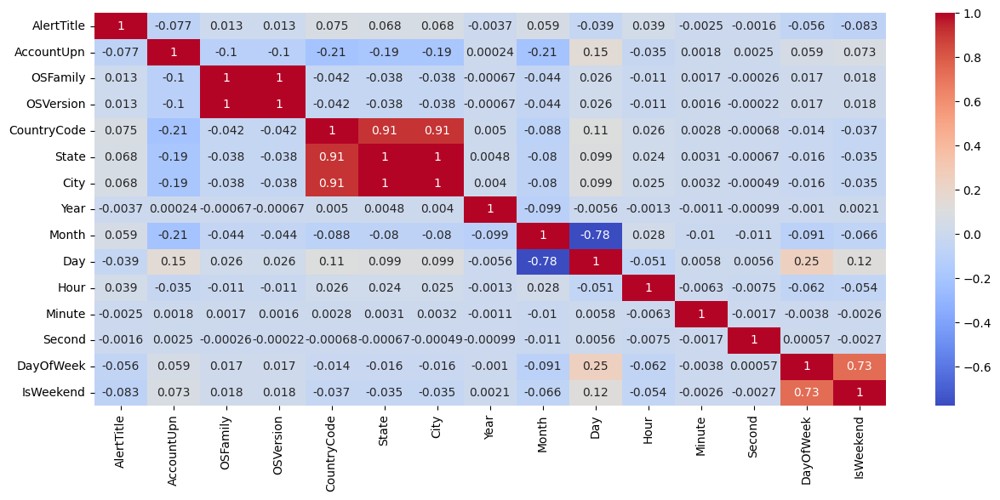

In [157]:
plt.figure(figsize=(15,6))
train_corr = train.corr(numeric_only=True)
sns.heatmap(train_corr, annot=True, cmap='coolwarm')

<Axes: >

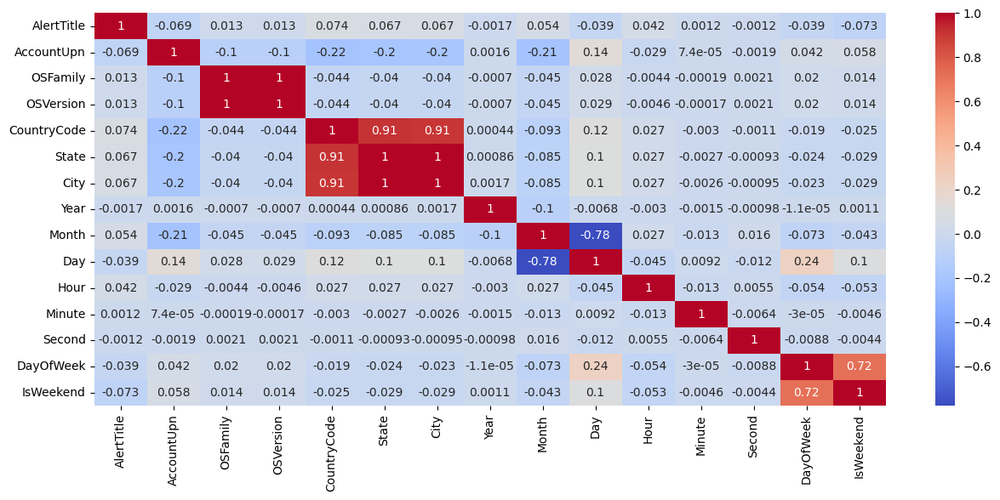

In [158]:
plt.figure(figsize=(15,6))
test_corr = test.corr(numeric_only=True)
sns.heatmap(test_corr, annot=True, cmap='coolwarm')

From the correlation plots of train and test data, the following features have high correlations:

OSFamily and OSVersion = 1
CountryCode and State = 0.91
CountryCode and City = 0.91
State and City = 1

Hence we can drop the features: OSFamily, CountryCode and State

Dropping the features : [OSFamily, CountryCOde and State], as a result of correlation analysis

In [159]:
train.drop(columns = ['OSFamily', 'CountryCode', 'State'],axis=1,inplace=True)
test.drop(columns = ['OSFamily', 'CountryCode', 'State'],axis=1,inplace=True)

In [160]:
train_num_cols = train.select_dtypes(include=np.number).columns
test_num_cols = test.select_dtypes(include=np.number).columns

train_cat_cols = train.select_dtypes(exclude=np.number).columns
test_cat_cols = test.select_dtypes(exclude=np.number).columns

### Imputations of IncidentGrade Feature in Train dataset, Encoding and Scaling

In [83]:
print("Train Data:")
for col in train_cat_cols:
    if train[col].isnull().sum() > 0:
        print(col,'=', round((train[col].isnull().sum() / len(train[col]) * 100),2),'%')
print('\n')
print("Test Data:")
for col in test_cat_cols:
    flag = 1
    if test[col].isnull().sum() > 0:
        print(col,'=', round((test[col].isnull().sum() / len(test[col]) * 100),2),'%')
        flag = 0
if flag == 1:
    print("None")


Train Data:
IncidentGrade = 0.53 %


Test Data:
None


#### Incident Grade Imputation in Train Data set using RandomForest

In [84]:
train['IncidentGrade'].isnull().sum()

np.int64(2656)

In [85]:
# Temporary fill for splitting
train['IncidentGrade'] = train['IncidentGrade'].fillna('Missing')


In [86]:
X_train = train.drop('IncidentGrade', axis=1)
y_train = train['IncidentGrade']

In [87]:
X_test = test.drop(columns=['IncidentGrade','Usage'],axis=1)
y_test = test['IncidentGrade']

In [88]:
len(X_train.columns)

24

In [89]:
X_train.shape,X_test.shape

((500000, 24), (500000, 24))

In [90]:
import pandas as pd
from sklearn.preprocessing import MultiLabelBinarizer, OneHotEncoder, LabelEncoder
import joblib


def encoding(X_train, X_test):

    X_train = X_train.copy()
    X_test = X_test.copy()

    # 1. MultiLabelBinarizer for MitreTechniques_List
    mlb = MultiLabelBinarizer()
    X_train_mitre_encoded = mlb.fit_transform(X_train['MitreTechniques_List'])
    X_test_mitre_encoded = mlb.transform(X_test['MitreTechniques_List'])

    # Convert the encoded data to DataFrame
    X_train_mitre_encoded_df = pd.DataFrame(X_train_mitre_encoded, columns=mlb.classes_)
    X_test_mitre_encoded_df = pd.DataFrame(X_test_mitre_encoded, columns=mlb.classes_)

    # Concatenate encoded features and remove original column
    X_train = pd.concat([X_train.drop(columns=['MitreTechniques_List']).reset_index(drop=True), X_train_mitre_encoded_df.reset_index(drop=True)], axis=1)
    X_test = pd.concat([X_test.drop(columns=['MitreTechniques_List']).reset_index(drop=True), X_test_mitre_encoded_df.reset_index(drop=True)], axis=1)

    # 2. Label Encoding for ThreatFamily
    label_encoder = LabelEncoder()
    # X_train['ThreatFamily_Encoded'] = label_encoder.fit_transform(X_train['ThreatFamily'])
    # X_test['ThreatFamily_Encoded'] = label_encoder.transform(X_test['ThreatFamily'])
    label_encoder.fit(X_train['ThreatFamily'].dropna())  # Fit only on training data and drop NaNs if any
    X_train['ThreatFamily_Encoded'] = X_train['ThreatFamily'].apply(lambda x: label_encoder.transform([x])[0] if x in label_encoder.classes_ else -1)
    X_test['ThreatFamily_Encoded'] = X_test['ThreatFamily'].apply(lambda x: label_encoder.transform([x])[0] if x in label_encoder.classes_ else -1)

    
    X_train.drop(columns=['ThreatFamily'], inplace=True)
    X_test.drop(columns=['ThreatFamily'], inplace=True)

    # 3. OneHotEncoder for categorical features
    onehot_columns = ['Category', 'EntityType', 'EvidenceRole', 'Roles', 'AntispamDirection', 'SuspicionLevel', 'LastVerdict']
    ohe = OneHotEncoder(sparse_output=False, drop='first', handle_unknown='ignore')

    # Apply OHE transformations
    X_train_ohe = ohe.fit_transform(X_train[onehot_columns])
    X_test_ohe = ohe.transform(X_test[onehot_columns])

    # Generate corresponding DataFrame with proper feature names
    X_train_ohe_df = pd.DataFrame(X_train_ohe, columns=ohe.get_feature_names_out(input_features=onehot_columns))
    X_test_ohe_df = pd.DataFrame(X_test_ohe, columns=ohe.get_feature_names_out(input_features=onehot_columns))

    # Remove the original columns and append the new OneHotEncoded features
    X_train_encoded = pd.concat([X_train.drop(columns=onehot_columns, errors='ignore').reset_index(drop=True), X_train_ohe_df.reset_index(drop=True)], axis=1)
    X_test_encoded = pd.concat([X_test.drop(columns=onehot_columns, errors='ignore').reset_index(drop=True), X_test_ohe_df.reset_index(drop=True)], axis=1)

    # Save transformers using joblib for consistency during inference
    joblib.dump(mlb, 'MultiLabelBinarizer.joblib')
    joblib.dump(label_encoder, 'LabelEncoder.joblib')
    joblib.dump(ohe, 'OneHotEncoder.joblib')

    # Return the encoded training and testing sets
    return X_train_encoded, X_test_encoded

X_train_encoded, X_test_encoded = encoding(X_train, X_test)

c:\Users\Praveen\Desktop\Microsoft_Classifying_Cybersecurity_Incidents\.venv\Lib\site-packages\sklearn\preprocessing\_encoders.py:242: UserWarning: Found unknown categories in columns [1, 4] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [91]:
X_train_encoded.shape, X_test_encoded.shape

((500000, 54), (500000, 54))

In [ ]:
X_train_combined = pd.concat([X_train_encoded,y_train],axis=1)
X_train_combined.head(2)

In [93]:
X_train_combined[X_train_combined['IncidentGrade'] == 'Missing']

,AlertTitle,AccountUpn,OSFamily,OSVersion,CountryCode,State,City,Year,Month,Day,...,Roles_Destination,Roles_Others,Roles_Source,Roles_Suspicious,AntispamDirection_Intraorg,AntispamDirection_Others,SuspicionLevel_Suspicious,LastVerdict_Others,LastVerdict_Suspicious,IncidentGrade
254,93858,124861,5,66,242,1445,10630,2024,6,11,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing
337,366,34031,5,66,242,1445,10630,2024,6,3,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing
476,91026,43890,5,66,242,1445,10630,2024,6,7,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing
562,99702,89409,5,66,242,1445,10630,2024,6,4,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing
819,67211,27203,5,66,242,1445,10630,2024,6,14,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
499391,56362,11350,5,66,242,1445,10630,2024,6,14,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing
499412,0,193062,5,66,242,1445,10630,2024,6,13,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing
499487,9,219304,5,66,242,1445,10630,2024,6,5,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing
499617,55677,426,5,66,242,1445,10630,2024,6,11,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Missing


In [94]:
X_train_combined.shape

(500000, 55)

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Separate rows with missing values in IncidentGrade
X_train_with_target = X_train_combined[X_train_combined['IncidentGrade'] != 'Missing']
X_train_missing_target = X_train_combined[X_train_combined['IncidentGrade'] == 'Missing']

# Prepare data for RandomForest
y_train_complete = X_train_with_target['IncidentGrade']
X_train_features = X_train_with_target.drop(columns=['IncidentGrade'])

# Train RandomForest for imputation
rf_imputer = RandomForestClassifier(random_state=42)
rf_imputer.fit(X_train_features, y_train_complete)

# Predict missing values
X_train_missing_target['IncidentGrade'] = rf_imputer.predict(X_train_missing_target.drop(columns=['IncidentGrade']))

# Combine the data back
X_train_combined = pd.concat([X_train_with_target, X_train_missing_target])

X_train_combined.reset_index(drop=True, inplace=True)

print(X_train_combined['IncidentGrade'].isnull().sum())



In [96]:
X_train = X_train_combined.drop('IncidentGrade',axis=1)
y_train = X_train_combined['IncidentGrade']

In [97]:
#Scaling

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train[['AlertTitle','AccountUpn','City']] = scaler.fit_transform(X_train[['AlertTitle','AccountUpn','City']])
X_test_encoded[['AlertTitle','AccountUpn','City']] = scaler.transform(X_test_encoded[['AlertTitle','AccountUpn','City']])
joblib.dump(scaler,'StandardScaler.joblib')


['StandardScaler.joblib']

In [98]:
X_train.shape, X_test_encoded.shape

((500000, 54), (500000, 54))

In [99]:
X_train.head(2)

,AlertTitle,AccountUpn,OSFamily,OSVersion,CountryCode,State,City,Year,Month,Day,...,Roles_Contextual,Roles_Destination,Roles_Others,Roles_Source,Roles_Suspicious,AntispamDirection_Intraorg,AntispamDirection_Others,SuspicionLevel_Suspicious,LastVerdict_Others,LastVerdict_Suspicious
0,-0.256897,0.723093,5,66,31,6,-3.808841,2024,6,4,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
1,-0.253666,-1.517822,5,66,242,1445,0.266187,2024,6,14,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0


In [100]:
y_train.head(2)

0     TruePositive
1    FalsePositive
Name: IncidentGrade, dtype: object

In [101]:
X_test_encoded.head(2)

,AlertTitle,AccountUpn,OSFamily,OSVersion,CountryCode,State,City,Year,Month,Day,...,Roles_Contextual,Roles_Destination,Roles_Others,Roles_Source,Roles_Suspicious,AntispamDirection_Intraorg,AntispamDirection_Others,SuspicionLevel_Suspicious,LastVerdict_Others,LastVerdict_Suspicious
0,-0.208260,-1.584381,5,66,242,1445,0.266187,2024,6,4,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
1,-0.257246,0.723093,0,0,242,1445,0.266187,2024,6,3,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0


In [102]:
y_test.head(2)

0    BenignPositive
1    BenignPositive
Name: IncidentGrade, dtype: object

In [103]:
X_train.to_csv("Train_X_train.csv",index=False)
y_train.to_csv("Train_y_train.csv",index=False)
X_test_encoded.to_csv("Test_X_test.csv",index=False)
y_test.to_csv("Test_y_test.csv",index=False)

### Random Under Sampling

In [2]:
X_train = pd.read_csv('Train_X_train.csv')
y_train = pd.read_csv('Train_y_train.csv')


In [3]:
X_train.head(2)

,AlertTitle,AccountUpn,OSFamily,OSVersion,CountryCode,State,City,Year,Month,Day,...,Roles_Contextual,Roles_Destination,Roles_Others,Roles_Source,Roles_Suspicious,AntispamDirection_Intraorg,AntispamDirection_Others,SuspicionLevel_Suspicious,LastVerdict_Others,LastVerdict_Suspicious
0,-0.256897,0.723093,5,66,31,6,-3.808841,2024,6,4,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
1,-0.253666,-1.517822,5,66,242,1445,0.266187,2024,6,14,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0


In [4]:
y_train.head(2)

,IncidentGrade
0,TruePositive
1,FalsePositive


In [5]:
y_train.value_counts()

IncidentGrade 
BenignPositive    217651
TruePositive      175221
FalsePositive     107128
Name: count, dtype: int64

In [6]:
from imblearn.under_sampling import RandomUnderSampler

rus = RandomUnderSampler(random_state=42)
X_train_balanced, y_train_balanced = rus.fit_resample(X_train, y_train)

In [ ]:
# from imblearn.combine import SMOTETomek,SMOTEENN

# # # Initialize SMOTETomek
# smote_tomek = SMOTETomek(random_state=42)
# # smote_enn = SMOTEENN(random_state=42)

# # # Resample the training data
# X_train_balanced, y_train_balanced = smote_tomek.fit_resample(X_train, y_train)
# # # X_train_balanced, y_train_balanced = smote_enn.fit_resample(X_train, y_train)

In [7]:
y_train_balanced.value_counts()

IncidentGrade 
BenignPositive    107128
FalsePositive     107128
TruePositive      107128
Name: count, dtype: int64

In [8]:
X_train_balanced.to_csv('Train_X_train_balanced_RUS.csv',index=False)
y_train_balanced.to_csv('Train_y_train_balanced_RUS.csv',index=False)

### Model Building

In [9]:
X_train = pd.read_csv('Train_X_train_balanced_RUS.csv')
y_train = pd.read_csv('Train_y_train_balanced_RUS.csv')
X_test = pd.read_csv('Test_X_test.csv')
y_test = pd.read_csv('Test_y_test.csv')

In [10]:
X_train.shape, X_test.shape

((321384, 54), (500000, 54))

In [11]:
y_train.shape, y_test.shape

((321384, 1), (500000, 1))

In [12]:
# Combine X_train and y_train into a single DataFrame for stratified sampling
train_data = pd.concat([X_train, y_train], axis=1)

# Ensure y_train is in a column if X_train is a DataFrame
train_data.columns = list(X_train.columns) + ['target']

# Perform stratified sampling
sampled_data = train_data.groupby('target', group_keys=False).apply(
    lambda x: x.sample(frac=0.1, random_state=42)
)

# Separate the sampled data back into features and target
sampled_X_train = sampled_data.drop(columns=['target'])
sampled_y_train = sampled_data['target']


C:\Users\Praveen\AppData\Local\Temp\ipykernel_15836\3909628571.py:8: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled_data = train_data.groupby('target', group_keys=False).apply(


In [13]:
sampled_X_train.shape, sampled_y_train.shape

((32139, 54), (32139,))

In [14]:
sampled_y_train.value_counts()

target
BenignPositive    10713
FalsePositive     10713
TruePositive      10713
Name: count, dtype: int64

In [15]:
# a = y_train.values.ravel()
b = y_test.values.ravel()

In [16]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
y_train = label_encoder.fit_transform(sampled_y_train)
y_test = label_encoder.transform(b)


In [17]:
label_encoder.classes_

array(['BenignPositive', 'FalsePositive', 'TruePositive'], dtype=object)

In [18]:
from sklearn.metrics import (
    accuracy_score, 
    precision_score, 
    recall_score, 
    f1_score, 
    roc_auc_score, 
    classification_report
)

def model_validation_classification(xtrain, ytrain, xtest, ytest, model_list):
    best_model = None
    best_metrics = None
    best_score = -float('inf')
    model_results = {}

    for model in model_list:
        model.fit(xtrain, ytrain)

        # Predictions on train data
        train_pred = model.predict(xtrain)
        train_proba = model.predict_proba(xtrain) if hasattr(model, "predict_proba") else None
        train_accuracy = accuracy_score(ytrain, train_pred)
        train_precision = precision_score(ytrain, train_pred, average='weighted')
        train_recall = recall_score(ytrain, train_pred, average='weighted')
        train_f1 = f1_score(ytrain, train_pred, average='weighted')
        train_roc_auc = (
            roc_auc_score(ytrain, train_proba, average='weighted', multi_class='ovr') 
            if train_proba is not None 
            else None
        )

        # Predictions on test data
        test_pred = model.predict(xtest)
        test_proba = model.predict_proba(xtest) if hasattr(model, "predict_proba") else None

        test_accuracy = accuracy_score(ytest, test_pred)
        test_precision = precision_score(ytest, test_pred, average='weighted')
        test_recall = recall_score(ytest, test_pred, average='weighted')
        test_f1 = f1_score(ytest, test_pred, average='weighted')
        test_roc_auc = (
            roc_auc_score(ytest, test_proba, average='weighted', multi_class='ovr') 
            if test_proba is not None 
            else None
        )

        metrics = {
            'train_scores': {
                'Accuracy': train_accuracy,
                'Precision': train_precision,
                'Recall': train_recall,
                'F1': train_f1,
                'ROC-AUC': train_roc_auc
            },
            'test_scores': {
                'Accuracy': test_accuracy,
                'Precision': test_precision,
                'Recall': test_recall,
                'F1': test_f1,
                'ROC-AUC': test_roc_auc
            }
        }

        model_results[model] = metrics

        if test_f1 > best_score:  
            best_score = test_f1
            best_model = model
            best_metrics = metrics

    print("\nAll Model Metrics:")
    for mod, mets in model_results.items():
        print(f"\nModel: {mod}")
        print("Training Scores:", mets['train_scores'])
        print("Testing Scores:", mets['test_scores'])

    return best_model, best_metrics

In [89]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import RandomizedSearchCV
from xgboost import XGBClassifier
from sklearn.metrics import f1_score, precision_score, recall_score, confusion_matrix, classification_report

model_list = [
    LogisticRegression(max_iter=100,random_state=42),
    DecisionTreeClassifier(random_state=42),
    RandomForestClassifier(random_state=42),
    GradientBoostingClassifier(random_state=42),
    XGBClassifier(),
    KNeighborsClassifier()
    
]

best_model, best_metrics = model_validation_classification(sampled_X_train, y_train, X_test, y_test, model_list)

print("\nBest Model:", best_model)
print("Best Model Metrics:", best_metrics)

c:\Users\Praveen\Desktop\Microsoft_Classifying_Cybersecurity_Incidents\.venv\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



All Model Metrics:

Model: LogisticRegression(random_state=42)
Training Scores: {'Accuracy': 0.43751101992402264, 'Precision': np.float64(0.44686839314442917), 'Recall': np.float64(0.43751101992402264), 'F1': np.float64(0.4356784133796049), 'ROC-AUC': np.float64(0.6181010751688267)}
Testing Scores: {'Accuracy': 0.461494, 'Precision': np.float64(0.4801598157130946), 'Recall': np.float64(0.461494), 'F1': np.float64(0.46510353670132915), 'ROC-AUC': np.float64(0.6332545691253073)}

Model: DecisionTreeClassifier(random_state=42)
Training Scores: {'Accuracy': 0.999855739176431, 'Precision': np.float64(0.9998557436310561), 'Recall': np.float64(0.999855739176431), 'F1': np.float64(0.9998557367583352), 'ROC-AUC': np.float64(0.9999999729570941)}
Testing Scores: {'Accuracy': 0.628202, 'Precision': np.float64(0.6345830690347515), 'Recall': np.float64(0.628202), 'F1': np.float64(0.6296759864538171), 'ROC-AUC': np.float64(0.7176969942389008)}

Model: RandomForestClassifier(random_state=42)
Training

#### Tuning - RandomForest Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import classification_report

# Define the model
rf = RandomForestClassifier(class_weight='balanced',random_state=42)

param_grid = {
    'n_estimators': [200, 210, 220, 230, 250],
    'max_depth': [14, 15, 16, 17, 18],
    'min_samples_split': [5, 10, 15, 20],
    'min_samples_leaf': [ 1, 2, 3, 4, 5]
}

random_search = RandomizedSearchCV(
    estimator=rf,
    param_distributions=param_grid,
    n_iter=10,
    scoring='f1',
    cv=5,
    verbose=2,
    random_state=42,
    n_jobs=-1
)

random_search.fit(sampled_X_train, y_train)

best_params = random_search.best_params_
best_model = random_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Model:", best_model)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


c:\Users\Praveen\Desktop\Microsoft_Classifying_Cybersecurity_Incidents\.venv\Lib\site-packages\numpy\ma\core.py:2881: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,
c:\Users\Praveen\Desktop\Microsoft_Classifying_Cybersecurity_Incidents\.venv\Lib\site-packages\sklearn\model_selection\_search.py:1103: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan]
  warnings.warn(


Best Parameters: {'n_estimators': 210, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_depth': 17}
Best Model: RandomForestClassifier(class_weight='balanced', max_depth=17,
                       min_samples_leaf=4, min_samples_split=5,
                       n_estimators=210, random_state=42)


In [26]:
from sklearn.ensemble import RandomForestClassifier

best_rf = RandomForestClassifier(
    n_estimators=210,
    max_depth=17,
    min_samples_split=5,
    min_samples_leaf=4,
    class_weight="balanced",
    random_state=42
)

best_rf.fit(sampled_X_train, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=17,
                       min_samples_leaf=4, min_samples_split=5,
                       n_estimators=210, random_state=42)

In [27]:
from sklearn.metrics import balanced_accuracy_score, classification_report

y_pred = best_rf.predict(X_test)

balanced_accuracy = balanced_accuracy_score(y_test, y_pred)
print(f'Balanced Accuracy: {balanced_accuracy}')

print(classification_report(y_test, y_pred, target_names=label_encoder.classes_))


Balanced Accuracy: 0.6683175073911344
                precision    recall  f1-score   support

BenignPositive       0.69      0.76      0.72    211593
 FalsePositive       0.54      0.56      0.55    108338
  TruePositive       0.79      0.69      0.74    180069

      accuracy                           0.69    500000
     macro avg       0.68      0.67      0.67    500000
  weighted avg       0.70      0.69      0.69    500000



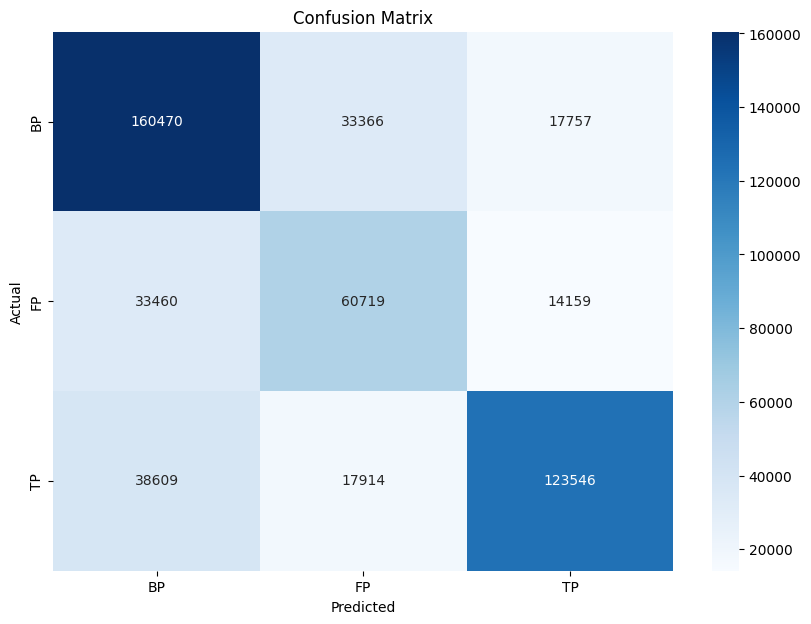

In [28]:
# Using  RUS
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['BP', 'FP', 'TP'], yticklabels=['BP', 'FP', 'TP'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
# #Using only SMOTE_Tomek
# import seaborn as sns
# import matplotlib.pyplot as plt
# from sklearn.metrics import confusion_matrix

# cm = confusion_matrix(y_test, y_pred)

# plt.figure(figsize=(10, 7))
# sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['BP', 'FP', 'TP'], yticklabels=['BP', 'FP', 'TP'])
# plt.xlabel('Predicted')
# plt.ylabel('Actual')
# plt.title('Confusion Matrix')
# plt.show()

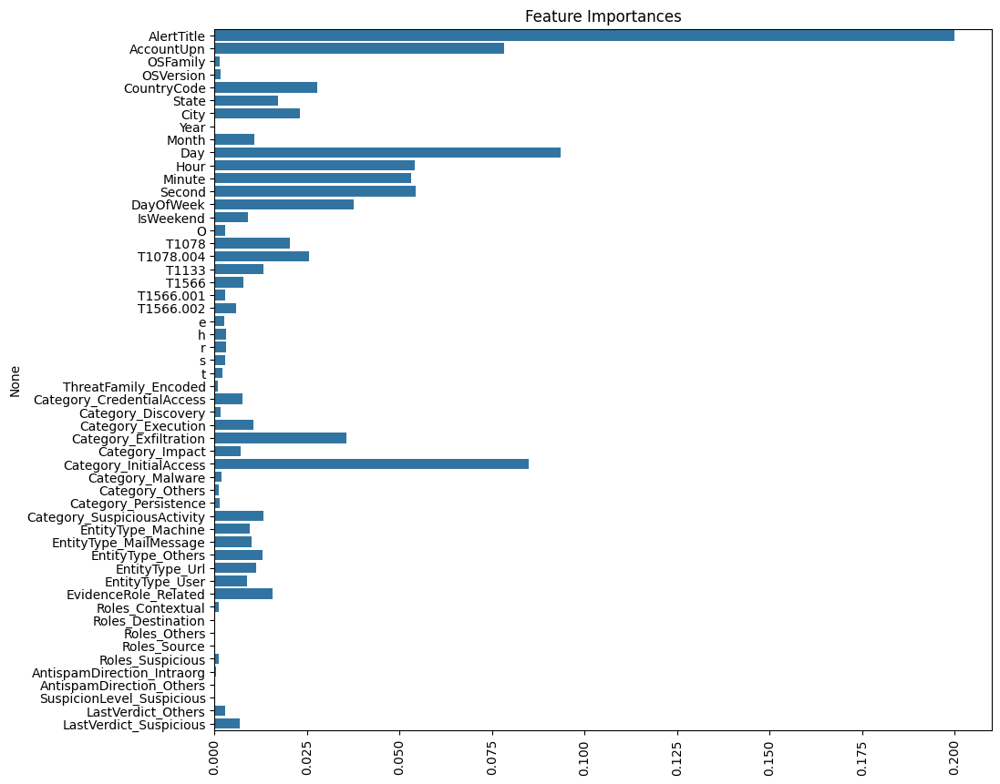

In [ ]:
feature_importances = rf.feature_importances_
features = X_train.columns

# Plotting the feature importances
plt.figure(figsize=(11, 10))
sns.barplot(x=feature_importances, y=features)
plt.xticks(rotation=90)
plt.title('Feature Importances')
plt.show()

In [29]:
feature_df = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances
})

# Sort features by importance
top_features = feature_df.sort_values(by='Importance', ascending=False).head(15)

In [30]:
top_features.Feature

0                 AlertTitle
9                        Day
33    Category_InitialAccess
1                 AccountUpn
12                    Second
10                      Hour
11                    Minute
13                 DayOfWeek
31     Category_Exfiltration
4                CountryCode
17                 T1078.004
6                       City
16                     T1078
5                      State
43      EvidenceRole_Related
Name: Feature, dtype: object

In [31]:
# Saving the model
joblib.dump(best_rf, 'Best_RandomForestModel.joblib')

['Best_RandomForestModel.joblib']